# Import Libraries

In [21]:
import numpy as np
import pandas as pd
from sklearn import linear_model
from sklearn import svm
import matplotlib.pyplot as plt
%matplotlib inline 

# Load and Process Data

In [44]:
# Read the file into a pandas data frame.
df = pd.read_csv("../data/childrenDiagnosis.csv", header=0, delim_whitespace=False,na_values='?') 
''' columns = ['Y', 'filename', 'sex', 'age', 'age_years', 'corpus', 'group',
       'child_TNW', 'child_TNS', 'examiner_TNW', 'freq_ttr', 'r_2_i_verbs',
       'mor_words', 'num_pos_tags', 'n_dos', 'repetition', 'retracing',
       'fillers', 's_1g_ppl', 's_2g_ppl', 's_3g_ppl', 'd_1g_ppl',
       'd_2g_ppl', 'd_3g_ppl', 'z_mlu_sli', 'z_mlu_td',
       'z_word_errors_sli', 'z_word_errors_td', 'z_r_2_i_verbs_sli',
       'z_r_2_i_verbs_td', 'z_utts_sli', 'z_utts_td', 'total_syl',
       'average_syl', 'mlu_words', 'mlu_morphemes', 'mlu100_utts',
       'verb_utt', 'dss', 'ipsyn_total', 'present_progressive',
       'propositions_in', 'propositions_on', 'plural_s',
       'irregular_past_tense', 'possessive_s', 'uncontractible_copula',
       'articles', 'regular_past_ed', 'regular_3rd_person_s',
       'irregular_3rd_person', 'uncontractible_aux', 'contractible_copula',
       'contractible_aux', 'word_errors', 'f_k', 'n_v', 'n_aux', 'n_3s_v',
       'det_n_pl', 'det_pl_n', 'pro_aux', 'pro_3s_v', 'total_error'] 
  '''
df1 = pd.DataFrame(df, columns=['Y', 'age_years',
       'child_TNW', 'child_TNS', 'examiner_TNW', 'freq_ttr', 'r_2_i_verbs',
       'mor_words', 'num_pos_tags', 'n_dos', 'repetition', 'retracing',
       'fillers', 's_1g_ppl', 's_2g_ppl', 's_3g_ppl', 'd_1g_ppl',
       'd_2g_ppl', 'd_3g_ppl', 'z_mlu_sli', 'z_mlu_td',
       'z_word_errors_sli', 'z_word_errors_td', 'z_r_2_i_verbs_sli',
       'z_r_2_i_verbs_td', 'z_utts_sli', 'z_utts_td', 'total_syl',
       'average_syl', 'mlu_words', 'mlu_morphemes', 'mlu100_utts',
       'verb_utt', 'dss', 'ipsyn_total', 'present_progressive',
       'propositions_in', 'propositions_on', 'plural_s',
       'irregular_past_tense', 'possessive_s', 'uncontractible_copula',
       'articles', 'regular_past_ed', 'regular_3rd_person_s',
       'irregular_3rd_person', 'uncontractible_aux', 'contractible_copula',
       'contractible_aux', 'word_errors', 'f_k', 'n_v', 'n_aux', 'n_3s_v',
       'det_n_pl', 'det_pl_n', 'pro_aux', 'pro_3s_v', 'total_error'])
df1.head(6)

,Y,age_years,child_TNW,child_TNS,examiner_TNW,freq_ttr,r_2_i_verbs,mor_words,num_pos_tags,n_dos,...,word_errors,f_k,n_v,n_aux,n_3s_v,det_n_pl,det_pl_n,pro_aux,pro_3s_v,total_error
0,1,13.750000,287,36,4,0.333,0.108108,252,29,0,...,8,1.210456,0,2,2,7,0,0,1,12
1,1,14.333333,368,42,27,0.274,0.050000,361,30,0,...,16,1.871708,0,4,0,5,0,0,0,9
2,1,13.333333,266,26,2,0.411,0.105263,246,32,0,...,0,2.240602,0,1,0,5,0,0,0,6
3,1,15.333333,405,40,21,0.359,0.148936,348,34,0,...,4,1.877762,1,0,0,11,0,0,0,12
4,1,14.666667,300,35,20,0.279,0.150000,294,30,0,...,8,0.339524,0,1,1,5,0,0,0,7
5,1,14.833333,224,31,26,0.377,0.052632,215,27,0,...,10,1.609315,0,0,0,5,0,0,0,5


In [39]:
# Shuffle rows and convert all data type to float
df2 = np.array(df1.sample(frac=1).astype('float', copy=False))

In [63]:
X = df2[:, 1:]
y = df2[:, 0]

X.shape

(1163, 50)

# Visualizing the Data

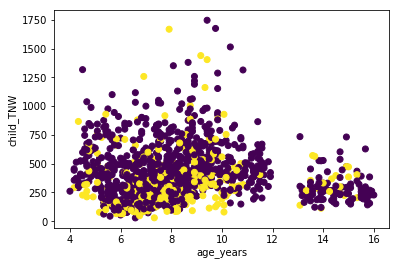

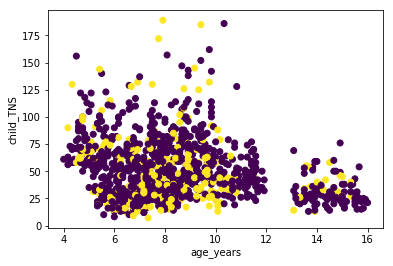

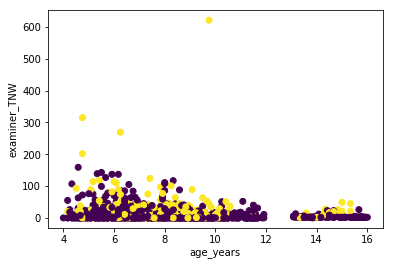

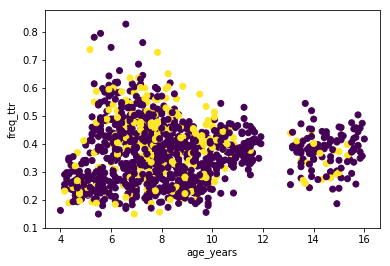

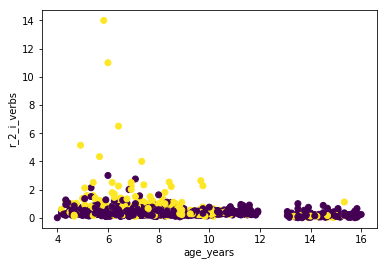

...

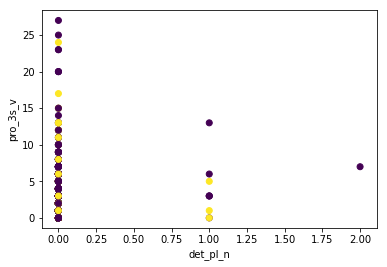

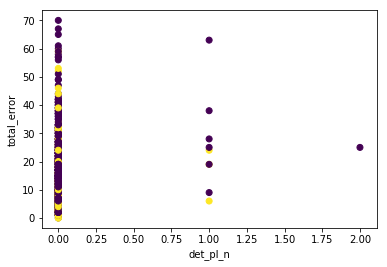

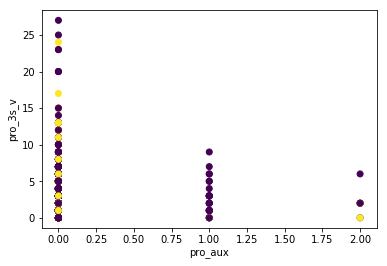

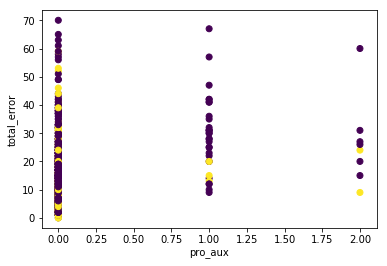

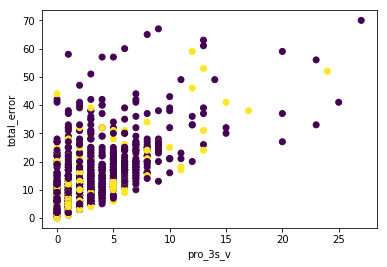

In [43]:
for i in range(0, len(X[0])):
    for j in range(i+1, len(X[0])):
        plt.scatter(X[:, i], X[:, j], c=y)
        plt.xlabel(df1.columns.values[i+1])
        plt.ylabel(df1.columns.values[j+1])
        plt.show()

# Feature Selection

In [378]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif

X_new = SelectKBest(f_classif, k=46).fit_transform(X, y)

In [379]:
# Splitting the dataset into training and test data.
# Select first 600 rows as training dataset and the remaining rows as test dataset.
X_train = X_new[:600, :]
Y_train = y[:600]
X_test = X_new[600:, :]
Y_test = y[600:]

# Support Vector Machines

# SVM Using Linear Kernel

In [375]:
acc_train_svm_linear = []
acc_test_svm_linear = []
c_svm_linear = []

In [376]:
def svm_linear(c):
    # Create an object of svm.SVC(probability = False, kernel = 'linear', C = c).
    svc = svm.SVC(probability = False, kernel = 'linear', C=c)
    print(c)
    # Fit the classifier on the training set.
    svc.fit(X_train, Y_train)
    
    # Find the prediction and accuracy on the training set.
    Yhat_svc_linear_train = svc.predict(X_train)
    acc_train = np.mean(Yhat_svc_linear_train == Y_train)
    acc_train_svm_linear.append(acc_train)
    print('Accuracy = {0:f}'.format(acc_train))
    
    # Find the prediction and accuracy on the test set.
    Yhat_svc_linear_test = svc.predict(X_test)
    acc_test = np.mean(Yhat_svc_linear_test == Y_test)
    acc_test_svm_linear.append(acc_test)
    print('Accuracy = {0:f}'.format(acc_test))
    
    c_svm_linear.append(c)

In [377]:
svm_linear(0.1)

0.1
Accuracy = 0.841667
Accuracy = 0.827709


# SVM using Radial Basis Function(RBF) Kernel

In [380]:
def svm_rbf(c, g):
    # Create an object of svm classifier using svm.SVC()
    # Pass probability = False, kernel = 'rbf', value of C = c and rbf paramter gamma = g.
    svc_rbf = svm.SVC(probability = False, kernel='rbf', C=c, gamma=g)
    print(c)
    print(g)
    # Fit the classifier on the training set.
    svc_rbf.fit(X_train, Y_train)
    
    # Find the prediction and accuracy on the training set.
    Yhat_svc_rbf_train = svc_rbf.predict(X_train)
    acc = np.mean(Yhat_svc_rbf_train == Y_train)
    print('Accuracy = {0:f}'.format(acc))
    
    # Find the prediction and accuracy on the test set.
    Yhat_svc_rbf_test = svc_rbf.predict(X_test)
    acc = np.mean(Yhat_svc_rbf_test == Y_test)
    print('Accuracy = {0:f}'.format(acc))
  

In [382]:
svm_rbf(0.1, 0.001)

0.1
0.001
Accuracy = 0.770000
Accuracy = 0.770870


# SVM using Polynomial Kernel

In [ ]:
acc_train_svm_poly=[]
